In [13]:
import os

from diff_viz import msd
from diff_viz import diffusion_modes
from diff_viz import feature_distribution_plots
from diff_viz import data_loading
from diff_viz import diff_utils
import pandas as pd
from os import getcwd, chdir
from diff_predictor import data_process
from diff_viz import diff_utils
import matplotlib.pyplot as plt
import numpy as np
import diff_classifier
from diff_classifier.features import unmask_track
import altair as alt

from diff_viz.heatmaps import plot_heatmap, plot_scatterplot, plot_trajectories
from diff_viz.viscosity import viscosity_from_diffusion_coefficient

In [2]:
phuong_data_path = '/Users/nelsschimek/Documents/nancelab/diff_viz/diff_viz/tests/testing_data/phuong_data/Compiled_Trajectories/'

In [3]:
healthy_files_cortex = os.listdir(phuong_data_path + '/Healthy_QD-BEV/cortex/')
ogd_files_cortex = os.listdir(phuong_data_path + '/OGD_QD-BEV/cortex')
print(len(healthy_files_cortex))
print(len(ogd_files_cortex))

16
32


In [4]:
healthy_files_striatum = os.listdir(phuong_data_path + '/Healthy_QD-BEV/striatum/')
ogd_files_striatum = os.listdir(phuong_data_path + '/OGD_QD-BEV/striatum')
print(len(healthy_files_striatum))
print(len(ogd_files_striatum))

45
57


In [5]:
msd_healthy_cortex = [file for file in healthy_files_cortex if 'msd_10' in file]
msd_ogd_cortex = [file for file in ogd_files_cortex if 'msd_10' in file]
print(len(msd_healthy_cortex))
print(len(msd_ogd_cortex))

msd_healthy_striatum = [file for file in healthy_files_striatum if 'msd_10' in file]
msd_ogd_striatum = [file for file in ogd_files_striatum if 'msd_10' in file]
print(len(msd_healthy_striatum))
print(len(msd_ogd_striatum))

6
12
15
22


In [6]:
huge_msd_list = msd_healthy_cortex + msd_ogd_cortex + msd_healthy_striatum + msd_ogd_striatum

In [7]:
def get_mean_geo_data(msd_files, filepath=None):
    """takes in a list of msd files and returns the mean of the geometric means and geometric standard errors

    Args:
        msd_files (list of string): files to average

    Returns:
        numpy array: averaged values across multiple CSVs
    """
    geo_means = []
    geo_sems = []
    
    for file in msd_files:
        msd_data = pd.read_csv(filepath+file)
        geo_mean, geosem = msd.get_geo_data(msd_data)
        geo_means.append(geo_mean)
        geo_sems.append(geosem)

    averaged_geo_means = np.mean(geo_means, axis=0)
    averaged_geo_sems = np.mean(geo_sems, axis=0)
    return averaged_geo_means, averaged_geo_sems

In [8]:
list_msd_healthy_cortex = []
list_msd_ogd_cortex = []
list_msd_healthy_striatum = []
list_msd_ogd_striatum = []

for file in msd_healthy_cortex:
    msd_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_healthy_cortex.append(np.array(geo_mean))

for file in msd_ogd_cortex:
    msd_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_ogd_cortex.append(geo_mean)

for file in msd_healthy_striatum:
    msd_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/striatum/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_healthy_striatum.append(geo_mean)

for file in msd_ogd_striatum:
    msd_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/striatum/' + file)
    geo_mean, geosem = msd.get_geo_data(msd_data)
    list_msd_ogd_striatum.append(geo_mean)

In [9]:
list_msd_healthy_cortex = np.array(list_msd_healthy_cortex)
list_msd_healthy_cortex

array([[        nan, -0.59483863,  0.18772292, ..., -1.43469576,
        -1.45159163, -1.1101281 ],
       [        nan, -1.73385705, -1.09473069, ..., -0.45721525,
        -0.4331578 , -0.90801623],
       [        nan, -2.21558242, -1.63939994, ..., -2.05517774,
        -2.14582698, -1.80945659],
       [        nan, -1.54746637, -0.95793538, ..., -1.66290591,
        -1.21761801, -0.84812506],
       [        nan, -1.32382609, -0.57791265, ...,         nan,
                nan,         nan],
       [        nan, -1.30241051, -0.58636919, ...,         nan,
                nan,         nan]])

In [ ]:
for file in list_msd_healthy_cortex:
    plt.plot(file[1:12])
plt.xlim(0, 12)
plt.title('Healthy Cortex')

In [ ]:
for file in list_msd_ogd_cortex:
    plt.plot(file[1:12])
plt.xlim(0, 12)
plt.title('OGD Cortex')

In [ ]:
for file in list_msd_healthy_striatum:
    plt.plot(file[1:12])
plt.xlim(0, 12)
plt.title('Healthy Striatum')

In [ ]:
for file in list_msd_ogd_striatum:
    plt.plot(file[1:12])
plt.xlim(0, 12)
plt.title('OGD Striatum')

In [10]:
healthy_cortex_geo_means, healthy_cortex_geo_sems = get_mean_geo_data(msd_healthy_cortex, filepath=phuong_data_path + '/Healthy_QD-BEV/cortex/')

In [11]:
ogd_cortex_geo_means, ogd_cortex_geo_sems = get_mean_geo_data(msd_ogd_cortex, filepath=phuong_data_path + '/OGD_QD-BEV/cortex/')

In [12]:
healthy_striatum_geo_means, healthy_striatum_geo_sems = get_mean_geo_data(msd_healthy_striatum, filepath=phuong_data_path + '/Healthy_QD-BEV/striatum/')

In [13]:
ogd_striatum_geo_means, ogd_striatum_geo_sems = get_mean_geo_data(msd_ogd_striatum, filepath=phuong_data_path + '/OGD_QD-BEV/striatum/')

In [14]:
cortex_geo_mean_df = pd.DataFrame({'healthy_cortex': healthy_cortex_geo_means, 'ogd_cortex': ogd_cortex_geo_means})
cortex_geo_sem_df = pd.DataFrame({'healthy_cortex': healthy_cortex_geo_sems, 'ogd_cortex': ogd_cortex_geo_sems})
striatum_geo_mean_df = pd.DataFrame({'healthy_striatum': healthy_striatum_geo_means, 'ogd_striatum': ogd_striatum_geo_means})
striatum_geo_sem_df = pd.DataFrame({'healthy_striatum': healthy_striatum_geo_sems, 'ogd_striatum': ogd_striatum_geo_sems})

In [19]:
full_geomean_df = pd.concat([cortex_geo_mean_df, striatum_geo_mean_df], axis=1)
print(len(full_geomean_df))
full_geosem_df = pd.concat([cortex_geo_sem_df, striatum_geo_sem_df], axis=1)
print(len(full_geosem_df))

651
651


In [20]:
tau = cortex_geo_mean_df.index.values/651
tau

array([0.        , 0.0015361 , 0.0030722 , 0.00460829, 0.00614439,
       0.00768049, 0.00921659, 0.01075269, 0.01228879, 0.01382488,
       0.01536098, 0.01689708, 0.01843318, 0.01996928, 0.02150538,
       0.02304147, 0.02457757, 0.02611367, 0.02764977, 0.02918587,
       0.03072197, 0.03225806, 0.03379416, 0.03533026, 0.03686636,
       0.03840246, 0.03993856, 0.04147465, 0.04301075, 0.04454685,
       0.04608295, 0.04761905, 0.04915515, 0.05069124, 0.05222734,
       0.05376344, 0.05529954, 0.05683564, 0.05837174, 0.05990783,
       0.06144393, 0.06298003, 0.06451613, 0.06605223, 0.06758833,
       0.06912442, 0.07066052, 0.07219662, 0.07373272, 0.07526882,
       0.07680492, 0.07834101, 0.07987711, 0.08141321, 0.08294931,
       0.08448541, 0.08602151, 0.0875576 , 0.0890937 , 0.0906298 ,
       0.0921659 , 0.093702  , 0.0952381 , 0.09677419, 0.09831029,
       0.09984639, 0.10138249, 0.10291859, 0.10445469, 0.10599078,
       0.10752688, 0.10906298, 0.11059908, 0.11213518, 0.11367

In [ ]:
plt.loglog(tau[1:], full_geomean_df['ogd_cortex'][1:], label='healthy_cortex')


In [ ]:
plt.plot(full_geomean_df['healthy_cortex'][0:12], label='healthy_cortex')
plt.plot(full_geomean_df['ogd_cortex'][0:12], label='ogd_cortex')
plt.plot(full_geomean_df['healthy_striatum'][0:12], label='healthy_striatum')
plt.plot(full_geomean_df['ogd_striatum'][0:12], label='ogd_striatum')
plt.legend()


In [23]:
def testing_msd_viz(doses,geomean_df,geosem_df,fps):
    """
    Visualize MSD data from diffusivity experiments.
    
    Parameters
    ----------
        doses (list):
            List of doses used in the experiment.
        geomean_df (pandas.DataFrame):
            DataFrame containing the mean-squared displacement data.
        geosem_df (pandas.DataFrame):
            DataFrame containing the standard error of the mean-squared displacement data.
        fps (int):
            Frames per second of the experiment.

    Returns
    -------
        fig (matplotlib.figure.Figure):
            Figure containing the MSD data.

    """
    count=0
    msd_dose_list=diff_utils.get_df_dose_list(doses,geomean_df)
    sem_dose_list=diff_utils.get_df_dose_list(doses,geosem_df)
    
    if len(doses)==1:
        tau=geomean_df.index.values/651
        fig,ax=plt.subplots(figsize=(6,6))
        plt.rcParams.update({'font.family':'helvetica'})
        handles=list(geomean_df.columns)
        #print('tau',tau)
        print('geomean_df[handle]', geomean_df[handles[0]]/2)#+geosem_df[handles[0]]/2)
        #print('geosem_df[handle]',geosem_df[handle])
    
        for handle in handles:
            ax.loglog(tau,geomean_df[handle])
            ax.set_xlabel('Lag time (s)',fontsize=16)
            ax.set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)
            
            
            ax.fill_between(tau,geomean_df[handle]+geosem_df[handle]/2,geomean_df[handle]-geosem_df[handle]/2,cmap='ocean',alpha=0.2)
            #ax.legend(handles,loc='best')
            #ax.set_xlim([0.008, 0.2])
            #ax.set_ylim([0.008,1])
            #ax.set_title(f'\n{doses[c]}\n', fontsize=16)
         
    else:                
        tau=geomean_df.index.values/651
        #fig,axes=plt.subplots(nrows=1,ncols=len(doses),figsize=(len(doses)*6,6))
        fig,axes=plt.subplots(nrows=1,ncols=1,figsize=(len(doses)*6,6))
        plt.rcParams.update({'font.family':'helvetica'})
        count=0
        
        for c in np.arange(0,len(doses)):
            while count<=c:
                sem_handles = list(sem_dose_list[c].columns)
                msd_handles = list(msd_dose_list[c].columns)
                print(msd_dose_list[count].values.flatten().shape)
                #print(msd_dose_list[count]+sem_dose_list[count]/2)
                axes.loglog(tau,msd_dose_list[count], label=doses[c])
                axes.fill_between(tau,
                                    (msd_dose_list[count]+sem_dose_list[count]/2).values.flatten(),
                                    (msd_dose_list[count]-sem_dose_list[count]/2).values.flatten(),
                                    cmap='ocean',
                                    alpha=0.2)
                axes.set_xlabel('\nLag time (s)',fontsize=16)               
                

                #axes[c].set_xlim([0.008, 1])
                #axes[c].set_ylim([0.008,1])
                axes.set_title(f'\n{doses[c]}\n', fontsize=16)
    
                if c == 0:
                    axes.set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)
    
                count+=1
                axes.legend(loc='best')
    return fig

In [ ]:
fig = testing_msd_viz(['healthy_cortex', 'ogd_cortex', 'healthy_striatum', 'ogd_striatum'], geomean_df=full_geomean_df, geosem_df=full_geosem_df, fps=100)

In [29]:
def msd_viz(doses,geomean_df,df_dose_list):
    count = 0
    
    # if len(doses) == 1:
    #     tau = geomean_df.index.values / 651
    #     fig, ax = plt.subplots(figsize=(5,5))
    #     plt.rcParams.update({'font.family':'helvetica'})
    #     handles = list(geomean_df.columns)
    #     #labels = [handle.split(stimulus+'_')[1] for handle in handles] # this wont work
    
    #     for handle in handles:
    #         ax.loglog(tau [0:70],geomean_df[handle][0:70]) #Can take out the 0:70 part to get the whole graph
    #         ax.set_xlabel('Lag time (s)',fontsize=16)
    #         ax.set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)
    #         #ax.legend(labels,loc='upper left') #this wont either
    #         ax.set_xlim([0.002, 0.05])
    #         ax.set_ylim([0.0009,1.3])
    #         #axes[c].set_title(f'\n{doses[c]}\n', fontsize=16)
    #     ax.legend(handles)

         
   # else:                
    tau = geomean_df.index.values/651
    fig, axes = plt.subplots(nrows=1, ncols=len(doses),figsize=(12,6))
    plt.rcParams.update({'font.family':'helvetica'})
    count=0
    
    for c in np.arange(0,len(doses)):
        handles = list(df_dose_list[c].columns)
        times = []
        handles = list(df_dose_list[c].columns)
        #labels = [handle.split(stimulus+'_')[1] for handle in handles]
        axes[c].loglog(tau[0:70],df_dose_list[count][0:70])
        axes[c].set_xlabel('\nLag time (s)',fontsize=16)
        #axes[c].legend(labels,loc='best')
        axes[c].set_xlim([0.002, 0.02])
        axes[c].set_ylim([0.0009,10])
        axes[c].set_title(f'\n{doses[c]}\n', fontsize=16)

        if c == 0:
            axes[c].set_ylabel('Mean-squared displacement (μ$m^2$)',fontsize=16)

        count+=1
    return

In [26]:
def get_df_dose_list(doses,geo_df):
    df_dose_list = []
    
    for dose in doses:
        dose_df = pd.DataFrame()
        dose_cols = [col for col in geo_df.columns if dose in col]
        dose_df = geo_df.filter(dose_cols, axis=1)
        df_dose_list.append(dose_df)
        
    return df_dose_list

In [27]:
df_dose_list = get_df_dose_list(['healthy_cortex', 'ogd_cortex', 'healthy_striatum', 'ogd_striatum'], full_geomean_df)

In [ ]:
msd_viz(doses=['healthy_cortex', 'ogd_cortex', 'healthy_striatum', 'ogd_striatum'], geomean_df=full_geomean_df, df_dose_list=df_dose_list)

## Lets plot MSD plots for each video!

#### First, healthy cortex

In [ ]:
for file in msd_healthy_cortex:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + file), x_range=1, y_range=20, title='Healthy Cortex: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'Healthy_Cortex_' + file[:-4] + '_msd_plot.png')

In [ ]:
for file in msd_ogd_cortex:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + file), x_range=1, y_range=20, title='OGD Cortex: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'OGD_Cortex_' + file[:-4] + '_msd_plot.png')

In [ ]:
for file in msd_healthy_striatum:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/striatum/' + file), x_range=1, y_range=20, title='Healthy Striatum: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'Healthy_Striatum_' + file[:-4] + '_msd_plot.png')

In [ ]:
for file in msd_ogd_striatum:
    fig = msd.plot_individual_msds(df=pd.read_csv(phuong_data_path + '/OGD_QD-BEV/striatum/' + file), x_range=1, y_range=20, title='OGD Striatum: '+ file[:-4])
    fig.savefig('/Users/nelsschimek/Documents/nancelab/diff_viz/output/' + 'OGD_Striatum_' + file[:-4] + '_msd_plot.png')

# Features analysis

In [7]:
features_healthy_cortex = [file for file in healthy_files_cortex if 'features_100' in file]
features_ogd_cortex = [file for file in ogd_files_cortex if 'features_100' in file]
print(len(features_healthy_cortex))
print(len(features_ogd_cortex))

features_healthy_striatum = [file for file in healthy_files_striatum if 'features_100' in file]
features_ogd_striatum = [file for file in ogd_files_striatum if 'features_100' in file]
print(len(features_healthy_striatum))
print(len(features_ogd_striatum))

6
12
14
23


In [8]:
list_features_healthy_cortex = []
list_features_ogd_cortex = []
list_features_healthy_striatum = []
list_features_ogd_striatum = []

for file in features_healthy_cortex:
    feature_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/cortex/' + file)
    list_features_healthy_cortex.append(feature_data)

   

for file in features_ogd_cortex:
    feature_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + file)
    list_features_ogd_cortex.append(feature_data)
  

for file in features_healthy_striatum:
    feature_data = pd.read_csv(phuong_data_path + '/Healthy_QD-BEV/striatum/' + file)
    list_features_healthy_striatum.append(feature_data)
  

for file in features_ogd_striatum:
    feature_data = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/striatum/' + file)
    list_features_ogd_striatum.append(feature_data)


In [9]:
all_features_healthy_cortex = pd.concat(list_features_healthy_cortex)
all_features_healthy_cortex['target'] = 'healthy_cortex'
all_features_ogd_cortex = pd.concat(list_features_ogd_cortex)
all_features_ogd_cortex['target'] = 'ogd_cortex'
all_features_healthy_striatum = pd.concat(list_features_healthy_striatum)
all_features_healthy_striatum['target'] = 'healthy_striatum'
all_features_ogd_striatum = pd.concat(list_features_ogd_striatum)
all_features_ogd_striatum['target'] = 'ogd_striatum'

all_features = pd.concat([all_features_healthy_cortex, all_features_ogd_cortex, all_features_healthy_striatum, all_features_ogd_striatum])
all_features.shape

(5926, 74)

In [10]:
feature_list = ['alpha', # Fitted anomalous diffusion alpha exponenet
    'D_fit', # Fitted anomalous diffusion coefficient
    'kurtosis', # Kurtosis of track
    'asymmetry1', # Asymmetry of trajecory (0 for circular symmetric, 1 for linear)
    'asymmetry2', # Ratio of the smaller to larger principal radius of gyration
    'asymmetry3', # An asymmetric feature that accnts for non-cylindrically symmetric pt distributions
    'AR', # Aspect ratio of long and short side of trajectory's minimum bounding rectangle
    'elongation', # Est. of amount of extension of trajectory from centroid
    'boundedness', # How much a particle with Deff is restricted by a circular confinement of radius r
    'fractal_dim', # Measure of how complicated a self similar figure is
    'trappedness', # Probability that a particle with Deff is trapped in a region
    'efficiency', # Ratio of squared net displacement to the sum of squared step lengths
    'straightness', # Ratio of net displacement to the sum of squared step lengths
    'MSD_ratio', # MSD ratio of the track
    'Deff1', # Effective diffusion coefficient at 0.33 s
    'Deff2', # Effective diffusion coefficient at 3.3 s
]

In [11]:
all_features_cleaned = all_features[~all_features[list(set(feature_list)-set(['Deff2', 'Mean Deff2']))].isin([np.inf, np.nan, -np.inf]).any(axis=1)]
all_features_cleaned.shape

(5662, 74)

In [26]:
hist1 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'healthy_cortex']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

hist2 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'ogd_cortex']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

hist3 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'healthy_striatum']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

hist4 = alt.Chart(all_features_cleaned[all_features_cleaned['target'] == 'ogd_striatum']).mark_bar().encode(
    alt.X('frames', bin=True, title='Frames'),
    alt.Y('count()', title='Count'),
)

layered_hist = alt.layer(hist1, hist2, hist3, hist4).resolve_scale(y='independent')

layered_hist.display()

alt.LayerChart(...)

In [34]:
alt.data_transformers.disable_max_rows()


alt.Chart(all_features_cleaned).mark_bar(opacity=0.5, interpolate='step').encode(
    alt.X('frames:Q', bin=alt.Bin(maxbins=100), title='Frames'),
    alt.Y('count()', title='Count'),
    color='target:N'
)

alt.Chart(...)

In [16]:
all_features_cleaned[feature_list].max()

alpha           1.049867e+01
D_fit           1.418753e+02
kurtosis        5.703028e+01
asymmetry1      1.000000e+00
asymmetry2      9.927357e-01
asymmetry3      6.931472e-01
AR              2.700000e+16
elongation      1.000000e+00
boundedness     4.925299e-01
fractal_dim     4.667345e+00
trappedness    -8.446987e-02
efficiency      1.183386e+01
straightness    1.000000e+00
MSD_ratio       1.002696e+02
Deff1           7.170503e+01
Deff2           1.685698e+01
dtype: float64

In [17]:
all_features_cleaned

,Unnamed: 0,Track_ID,alpha,D_fit,kurtosis,asymmetry1,asymmetry2,asymmetry3,AR,elongation,...,Mean SN_Ratio,Std SN_Ratio,Mean Deff1,Std Deff1,Mean Deff2,Std Deff2,X.1,Deff conversions,target,Median Deff
0,0.0,0,0.283245,17.833916,2.691678,0.476557,0.428019,0.083617,2.162082,0.537483,...,0.431062,0.068042,4.009773,0.130877,NaN,NaN,NaN,NaN,healthy_cortex,NaN
1,1.0,1,0.504130,5.218019,1.680688,0.704248,0.295689,0.159863,1.534311,0.348241,...,0.441962,0.000000,1.722601,0.000000,NaN,NaN,NaN,NaN,healthy_cortex,NaN
2,2.0,2,0.703222,19.254216,2.012940,0.767341,0.257118,0.191894,1.994797,0.498696,...,0.313880,0.018099,11.364866,1.244951,NaN,NaN,NaN,NaN,healthy_cortex,NaN
3,3.0,3,1.897738,1.731123,2.099662,0.974466,0.080413,0.449766,3.898966,0.743522,...,0.313880,0.018099,11.364866,1.244951,NaN,NaN,NaN,NaN,healthy_cortex,NaN
4,4.0,4,0.931836,12.955392,1.579348,0.963946,0.095811,0.416155,2.937701,0.659598,...,0.313880,0.018099,11.364866,1.244951,NaN,NaN,NaN,NaN,healthy_cortex,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,NaN,145,0.140621,12.937076,2.325201,0.567504,0.375083,0.108996,1.378311,0.274474,...,0.355680,0.077359,2.690725,1.664250,7.24816,0.0,759.693973,NaN,ogd_striatum,NaN
146,NaN,146,0.286710,10.073930,4.642100,0.017346,0.875926,0.002190,1.069299,0.064808,...,0.259281,0.005826,6.658132,4.957548,NaN,NaN,867.310245,NaN,ogd_striatum,NaN
148,NaN,148,1.229518,2.665561,1.722727,0.825237,0.219053,0.229659,1.966163,0.491395,...,0.333711,0.120129,4.772702,5.366563,NaN,NaN,960.244043,NaN,ogd_striatum,NaN
149,NaN,149,2.246062,0.328207,2.080541,0.998159,0.021466,0.614065,6.637277,0.849336,...,0.438899,0.217417,8.064350,4.465332,NaN,NaN,618.912969,NaN,ogd_striatum,NaN


In [124]:
import altair as alt
import pandas as pd
import numpy as np

def plot_diffusion_modes_altair(df, label_column):
    # Transform the data frame to have a 'mode' column and a 'percentage' column
    transformed_df = []
    labels = df[label_column].unique()
    labels.sort()
    
    for label in labels:
        ecm = df[df[label_column] == label]
        total_count = len(ecm)
        
        superdiffusive_count = len(ecm[ecm['alpha'] > 1.1])
        brownian_count = len(ecm[(ecm['alpha'] <= 1.1) & (ecm['alpha'] >= 0.9)])
        subdiffusive_count = len(ecm[ecm['alpha'] < 0.9])
        
        # Note: The order here determines the stack order. Reverse it to match your requirements.
        transformed_df.append([label, 'Superdiffusive', superdiffusive_count / total_count])
        transformed_df.append([label, 'Brownian', brownian_count / total_count])
        transformed_df.append([label, 'Subdiffusive', subdiffusive_count / total_count])
    
    transformed_df = pd.DataFrame(transformed_df, columns=[label_column, 'Mode', 'Percentage'])
    
    # Ensure the order of modes matches desired stack order by sorting
    mode_order = ['Subdiffusive', 'Brownian', 'Superdiffusive']
    transformed_df['Mode'] = pd.Categorical(transformed_df['Mode'], categories=mode_order, ordered=True)
    transformed_df = transformed_df.sort_values('Mode')
    
    # Create the Altair chart for stacked bar chart with specified order
    chart = alt.Chart(transformed_df).mark_bar().encode(
        x=alt.X(f'{label_column}:N', title=label_column),
        y=alt.Y('sum(Percentage):Q', title='Percentage', axis=alt.Axis(format='%')),
        color=alt.Color('Mode:N', scale=alt.Scale(domain=mode_order,
                                                  range=['#b7a57a', '#999999', '#4b2e83']),
                        sort=mode_order),
        #order=alt.Order('Mode', sort='descending')  # This controls the layering of bars in the stack
    ).properties(
        width=600,
        height=400
    )
    
    return chart


In [125]:
fig = plot_diffusion_modes_altair(all_features_cleaned, 'target')
fig

alt.Chart(...)

Text(0.5, 1.0, 'Percentage of Diffusion Modes per Condition, 100x')

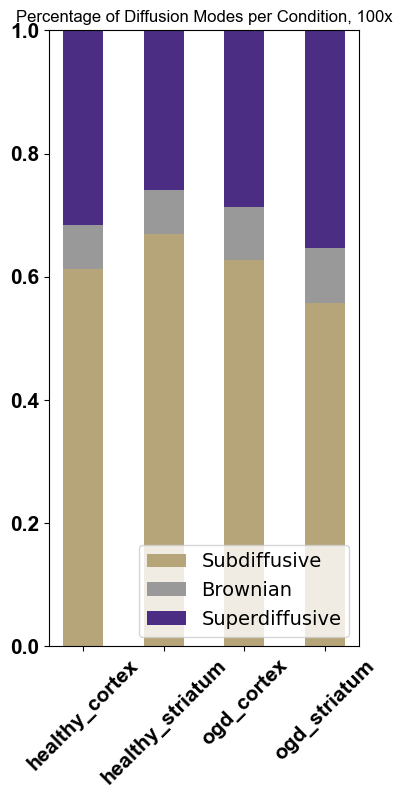

In [30]:
fig = diffusion_modes.plot_diffusion_modes(all_features_cleaned, 'target')
plt.xticks(rotation=45)
plt.title('Percentage of Diffusion Modes per Condition, 100x')
#plt.title('100x')

In [ ]:
for feature in feature_list:
    print(feature)
    # if feature in ['Deff2', 'AR', 'MSD_ratio']:
    #     pass
    # else:
    #     feature_distribution_plots.feature_violin_plot(all_df_cleaned, feature, 'target', title=feature)
    feature_distribution_plots.feature_violin_plot(all_features_cleaned, feature, 'target', title=feature, figsize=(10, 10))

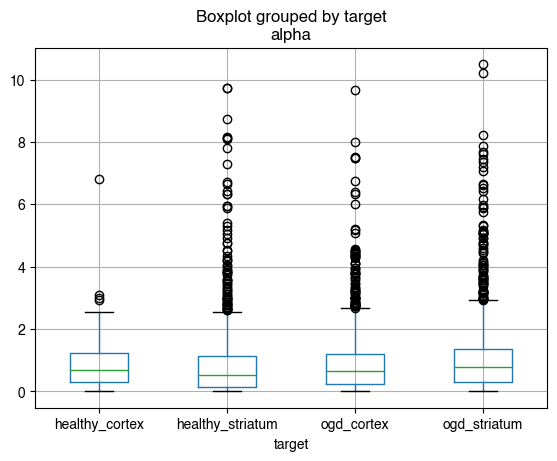

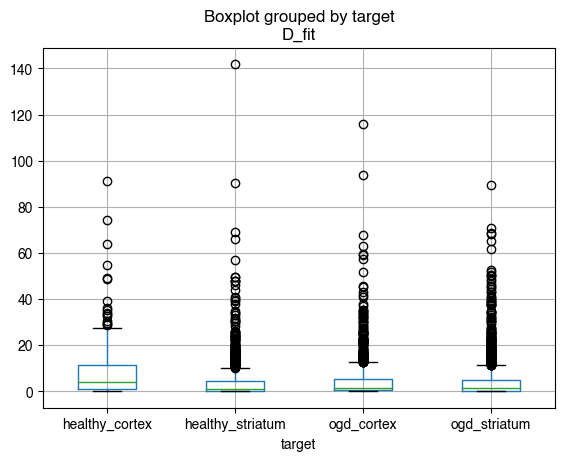

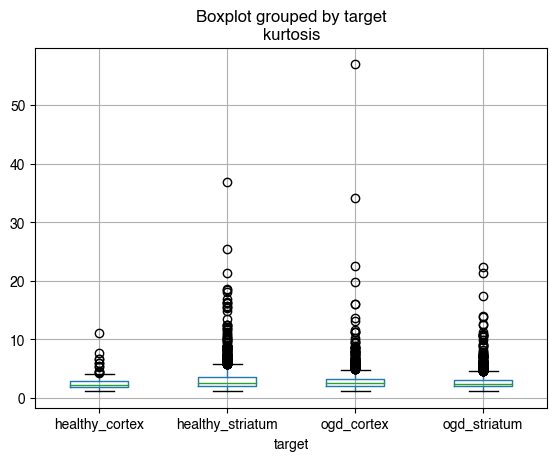

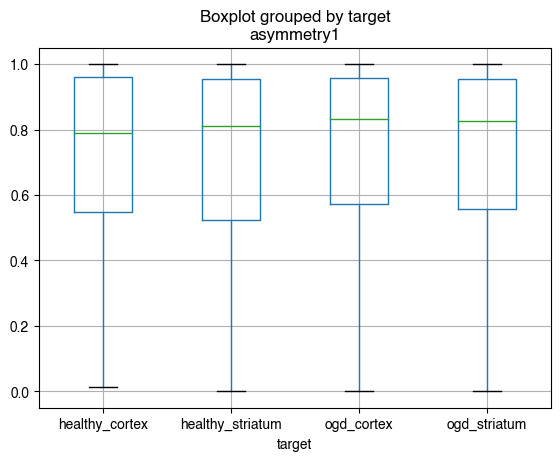

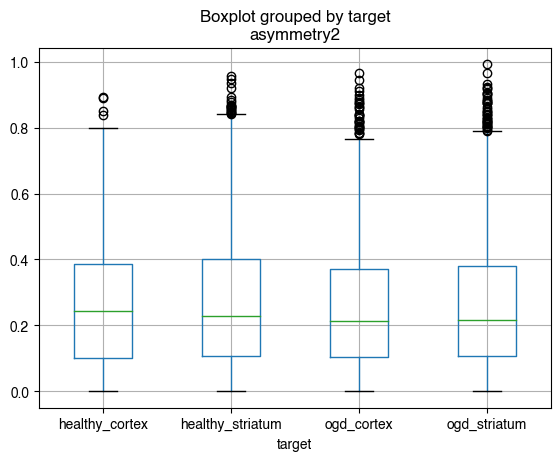

...

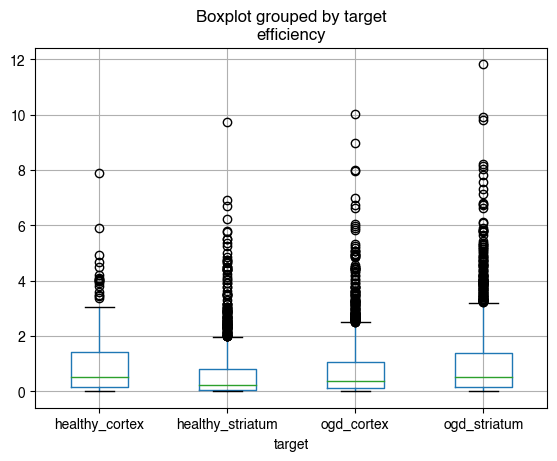

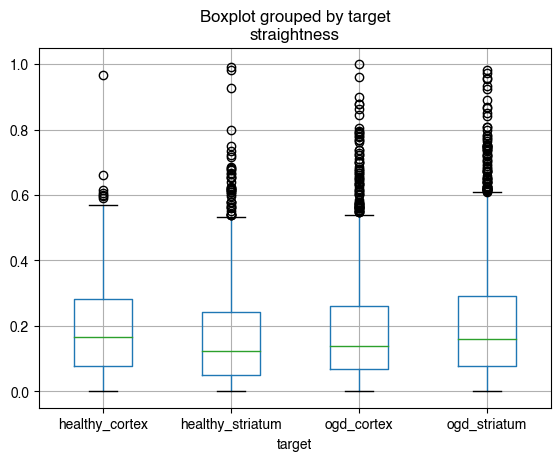

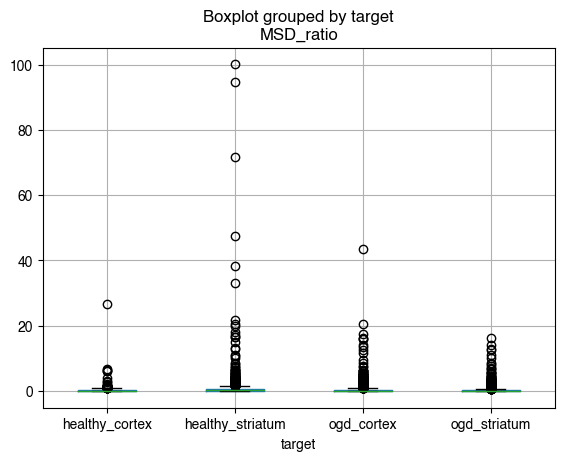

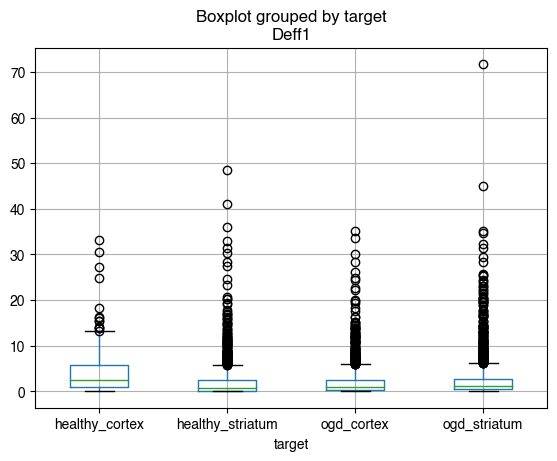

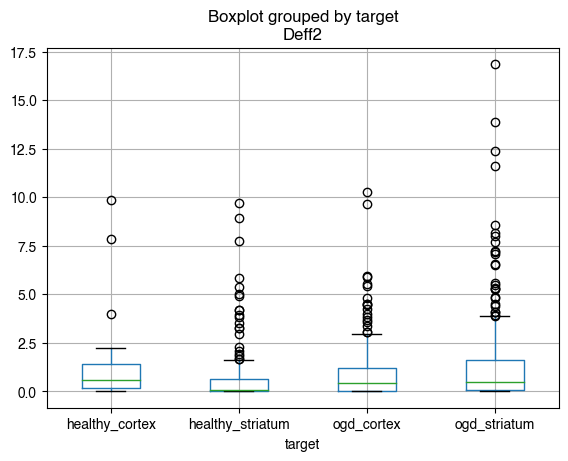

In [41]:
for feature in feature_list:
    all_features_cleaned.boxplot(feature, by='target')

In [59]:
# for file in features_healthy_cortex:
#     file = phuong_data_path + '/Healthy_QD-BEV/cortex/' + file
#     df = pd.read_csv(file)
#     fig = plot_scatterplot(df, 'Deff1', resolution=256, vmin=0, vmax=2, figsize=(4, 4))

In [57]:
# for file in features_healthy_striatum:
#     file = phuong_data_path + '/Healthy_QD-BEV/striatum/' + file
#     df = pd.read_csv(file)
#     fig = plot_scatterplot(df, 'Deff1', resolution=256, vmin=0, vmax=2)

In [58]:
# for file in features_ogd_cortex:
#     file_path = phuong_data_path + '/OGD_QD-BEV/cortex/' + file
#     df = pd.read_csv(file_path)
#     fig = plot_scatterplot(df, 'Deff1', resolution=128, vmin=0, vmax=2)
#     plt.title(file)

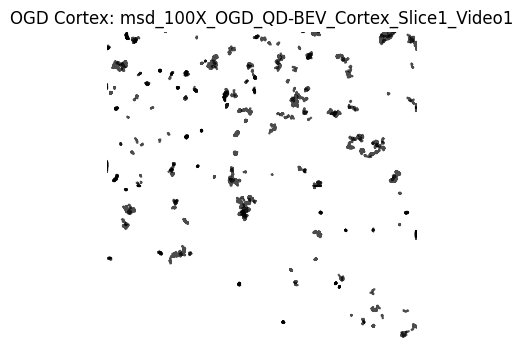

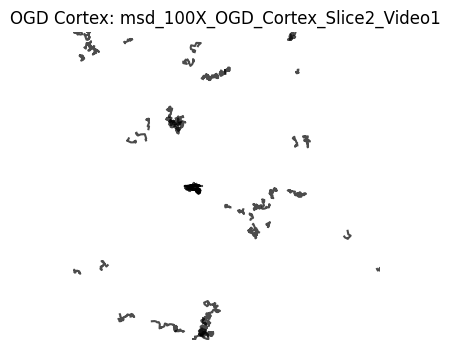

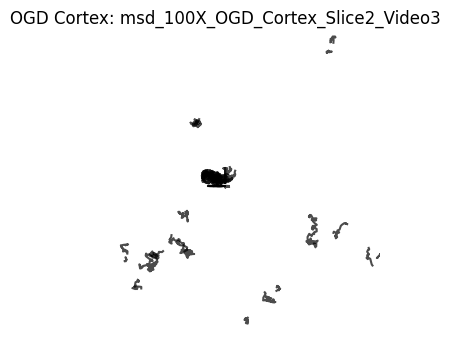

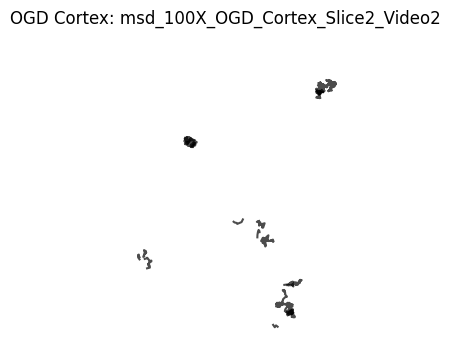

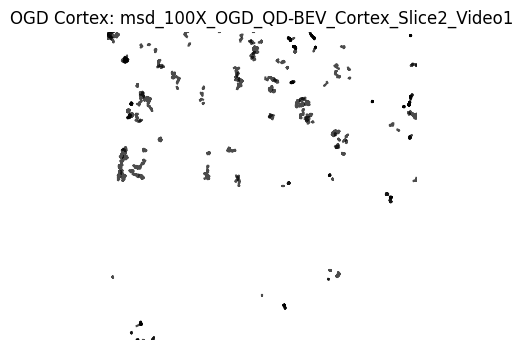

...

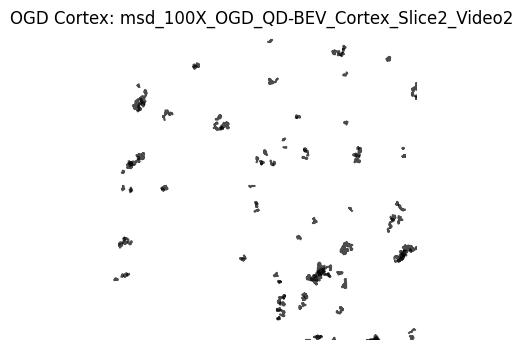

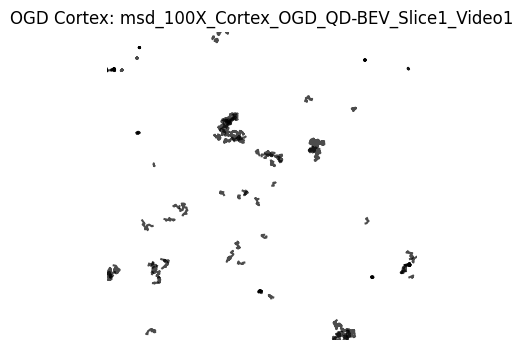

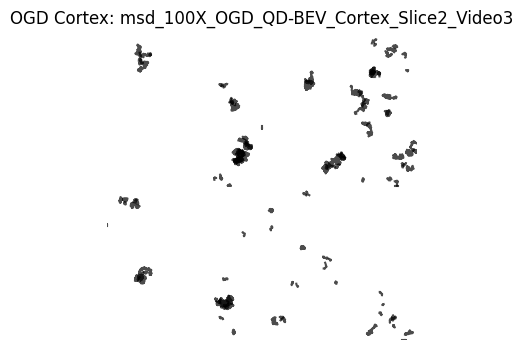

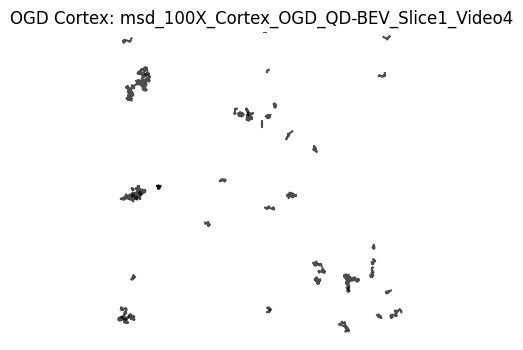

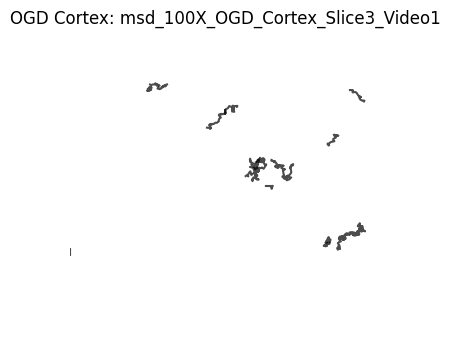

In [25]:
for file in msd_ogd_cortex:
    file_path = phuong_data_path + '/OGD_QD-BEV/cortex/' + file
    df = pd.read_csv(file_path)
    fig = plot_trajectories(df, resolution=256, figsize=(4, 4), subset=False)
    plt.title('OGD Cortex: '+ file[:-4])

In [31]:
import altair as alt
import pandas as pd
import numpy as np

def plot_trajectories_altair(msd_df, resolution=512, rows=4, cols=4, subset=False, size=1000):
    """
    Plot trajectories using Altair.

    Parameters
    ----------
    msd_df : DataFrame
        DataFrame containing the trajectories to be plotted.
    resolution : int
        Resolution of base image. Only needed to calculate bounds of image.
    rows : int
        Rows of base images used to build tiled image.
    cols : int
        Columns of base images used to build tiled images.
    subset : bool
        If True, a subset of 'size' trajectories will be randomly selected and plotted.
    size : int
        Number of trajectories to plot if subset is True.
    """
    # Determine the number of particles and select a subset if requested
    particles = msd_df['Track_ID'].nunique()
    if subset:
        selected_particles = np.random.choice(msd_df['Track_ID'].unique(), size=min(size, particles), replace=False)
        msd_df = msd_df[msd_df['Track_ID'].isin(selected_particles)]
    
    # Create the Altair chart
    chart = alt.Chart(msd_df).mark_line(opacity=0.7, color='black').encode(
        x=alt.X('X:Q', scale=alt.Scale(domain=(0, resolution*cols))),
        y=alt.Y('Y:Q', scale=alt.Scale(domain=(0, resolution*rows))),
        detail='Track_ID:N'  # This ensures each track is plotted as a separate line
    ).properties(
        width=resolution*cols,
        height=resolution*rows
    ).configure_view(
        strokeWidth=0  # Removes the border around the chart
    )

    return chart


In [26]:
alt.data_transformers.disable_max_rows()
plot_trajectories_altair(pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[6]), resolution=256, rows=4, cols=4, subset=True, size=100)

alt.Chart(...)

In [32]:
import altair as alt
import pandas as pd
import numpy as np

def plot_trajectories_altair_interactive(msd_df, resolution=512, rows=4, cols=4, subset=True, size=1000):
    """
    Plot interactive trajectories using Altair.

    Parameters
    ----------
    msd_df : DataFrame
        DataFrame containing the trajectories to be plotted.
    resolution : int
        Resolution of base image. Only needed to calculate bounds of image.
    rows : int
        Rows of base images used to build tiled image.
    cols : int
        Columns of base images used to build tiled images.
    subset : bool
        If True, a subset of 'size' trajectories will be randomly selected and plotted.
    size : int
        Number of trajectories to plot if subset is True.
    """
    # Determine the number of particles and select a subset if requested
    particles = msd_df['Track_ID'].nunique()
    if subset:
        selected_particles = np.random.choice(msd_df['Track_ID'].unique(), size=min(size, particles), replace=False)
        msd_df = msd_df[msd_df['Track_ID'].isin(selected_particles)]
    
    # Create the Altair chart
    chart = alt.Chart(msd_df).mark_line(opacity=0.7, color='black').encode(
        x=alt.X('X:Q', scale=alt.Scale(domain=(0, resolution*cols))),
        y=alt.Y('Y:Q', scale=alt.Scale(domain=(0, resolution*rows))),
        detail='Track_ID:N'  # This ensures each track is plotted as a separate line
    ).properties(
        width=resolution*cols,
        height=resolution*rows
    ).configure_view(
        strokeWidth=0  # Removes the border around the chart
    ).interactive()  # Enables zoom and pan interactivity

    return chart


In [ ]:
plot_trajectories_altair_interactive(pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[11]), resolution=256, rows=4, cols=4, subset=False, size=1000)

In [28]:
import pandas as pd
import numpy as np
import altair as alt

def sample_trajectories(msd_df, N=5, plot=False, resolution=512, rows=4, cols=4):
    """
    Return and optionally plot N randomly sampled trajectories.

    Parameters
    ----------
    msd_df : DataFrame
        DataFrame containing the trajectories to be sampled and plotted.
    N : int
        Number of trajectories to sample.
    plot : bool
        If True, plots the sampled trajectories.
    resolution : int
        Resolution of base image, used for plotting.
    rows : int
        Number of rows in the tiled image setup, used for plotting.
    cols : int
        Number of columns in the tiled image setup, used for plotting.

    Returns
    -------
    sampled_trajectories : DataFrame
        A DataFrame containing the sampled trajectories.
    charts : list of alt.Chart (optional)
        A list of Altair Chart objects if plotting is requested.
    """
    # Sample N unique track IDs without replacement
    unique_tracks = msd_df['Track_ID'].unique()
    sampled_track_ids = np.random.choice(unique_tracks, size=min(N, len(unique_tracks)), replace=False)
    
    # Filter the DataFrame to include only the sampled track IDs
    sampled_trajectories = msd_df[msd_df['Track_ID'].isin(sampled_track_ids)]
    
    if plot:
        charts = []
        for track_id in sampled_track_ids:
            track_df = sampled_trajectories[sampled_trajectories['Track_ID'] == track_id]
            chart = alt.Chart(track_df).mark_line(opacity=0.7, color='black').encode(
                x=alt.X('X:Q', scale=alt.Scale(domain=(0, resolution*cols))),
                y=alt.Y('Y:Q', scale=alt.Scale(domain=(0, resolution*rows))),
            ).properties(
                title=f'Track ID: {track_id}',
                width=400,
                height=400
            ).interactive()
            charts.append(chart)
        return sampled_trajectories, charts

    return sampled_trajectories


In [55]:
def get_traj_list(df):   

    output_df = pd.DataFrame()

    trackids = df.Track_ID.unique()
    partcount = trackids.shape[0]

    for particle in range(0, partcount):
        single_track_masked =\
            df.loc[df['Track_ID'] ==
                    trackids[particle]].sort_values(['Track_ID', 'Frame'],
                                                    ascending=[
                                                    1,
                                                    1]).reset_index(drop=True)
        single_track = unmask_track(single_track_masked)
        # alph, coef = alpha_calc(single_track)
        # if (len(single_track) > 66) & (alph > 0):
        #     rc_short = (single_track['MSDs'][33] / 4 * 33) / (single_track['MSDs'][7] / 4*7)
        #     rc_long = (single_track['MSDs'][66] / 4 * 66) / (single_track['MSDs'][33] / 4*33)
        #     new_dict = {
        #         'X': single_track['X'],
        #         'Y': single_track['Y'],
        #         'alpha': alph,
        #         'rc_short': rc_short,
        #         'rc_long': rc_long
        #    }
        if output_df.empty:
            output_df = single_track
        else:
            output_df = pd.concat([output_df, single_track])
    return output_df

In [69]:
test_df = pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[6])
test_df['Track_ID'].nunique()

228

In [70]:
output = get_traj_list(pd.read_csv(phuong_data_path + '/OGD_QD-BEV/cortex/' + msd_ogd_cortex[6]))
output['Track_ID'].nunique()

228

In [75]:
output

,Frame,Track_ID,X,Y,MSDs,Gauss,Quality,SN_Ratio,Mean_Intensity
0,0.0,0.0,301.783000,761.64300,0.000000,0.000000,0.542000,0.2680,134.48900
1,1.0,0.0,299.768000,756.54100,5.758325,1.256325,0.637000,0.2490,133.26200
2,2.0,0.0,298.647600,757.68700,9.749280,0.390753,0.622600,0.2342,133.27300
3,3.0,0.0,297.527200,758.83300,16.222455,0.345829,0.608200,0.2194,133.28400
4,4.0,0.0,296.406800,759.97900,25.644378,0.369808,0.593800,0.2046,133.29500
...,...,...,...,...,...,...,...,...,...
9,9.0,227.0,753.337250,296.03350,85.244014,0.482453,0.747250,0.3170,140.13550
10,10.0,227.0,752.713625,296.53025,94.190787,0.450431,0.755625,0.3235,140.28475
11,11.0,227.0,752.090000,297.02700,108.871831,0.363643,0.764000,0.3300,140.43400
12,12.0,227.0,752.441000,296.04000,100.611422,0.596907,0.940000,0.4280,141.14500


In [137]:
def plot_all_particles_altair(df, color_by='Track_ID'):

    brush = alt.selection_interval()
    # Setup color encoding based on the provided column
    color_scale = alt.Scale(scheme='category10')  # You can customize the color scheme
    color_encoding = alt.Color(f'{color_by}:N', scale=color_scale, legend=None)  # Set legend=None to hide legend
       # Create the Altair chart
    trajectories = alt.Chart(df).mark_line(opacity=0.7).encode(
        x=alt.X('X:Q'),# scale=alt.Scale(domain=(0, resolution*cols))),
        y=alt.Y('Y:Q'),# scale=alt.Scale(domain=(0, resolution*rows))),
        color=color_encoding,
        detail='Track_ID:N',  # This ensures each track is plotted as a separate line
        order='Frame:N',
    # ).properties(
    #     width=resolution*cols,
    #     height=resolution*rows
    # ).configure_view(
    #     strokeWidth=0  # Removes the border around the chart
    ).add_selection(
        brush
    )  # Enables zoom and pan interactivity

    # Text mark to show unique Track IDs based on the selection
    unique_track_ids = alt.Chart(df).mark_text(align='left', dx=5, dy=-5).encode(
        x=alt.value(5),  # Position the text to the right of the selection
        y=alt.value(5),  # Position the text to the top of the selection
        text=alt.Text('Track_ID:N', aggregate='distinct'),
        opacity=alt.condition(brush, alt.value(1), alt.value(0))
    ).transform_filter(
        brush
    )
    chart = trajectories + unique_track_ids

    return chart

In [143]:
import altair as alt
import pandas as pd
import numpy as np

# Assuming df is your DataFrame with 'X', 'Y', 'Track_ID', and 'Frame' columns

def plot_all_particles_altair_with_side_panel(df, color_by='Track_ID'):
    # Define an interval selection for selecting points in the plot
    brush = alt.selection_interval()

    # Setup color encoding based on the provided column
    color_scale = alt.Scale(scheme='category10')  # Customize the color scheme
    color_encoding = alt.Color(f'{color_by}:N', scale=color_scale, legend=None)  # Hide legend

    # Create the Altair chart for trajectories with interactive selection
    trajectories = alt.Chart(df).mark_line(opacity=0.7).encode(
        x='X:Q',
        y='Y:Q',
        color=color_encoding,
        detail='Track_ID:N',  # Ensures each track is plotted as a separate line
    ).add_selection(
        brush  # Adds interactive selection
    ).properties(
        width=500,
        height=300
    )

    # Creating a chart for displaying unique Track_IDs based on the selection
    # Use transform_filter to filter based on brush, and transform_window to ensure uniqueness
    unique_track_ids = alt.Chart(df).transform_filter(
        brush
    ).transform_aggregate(
        unique_ids='distinct(Track_ID)',
        groupby=['Track_ID']
    ).mark_text().encode(
        y=alt.Y('Track_ID:N', sort='ascending', axis=alt.Axis(title="Selected Track IDs")),
        text='Track_ID:N',
    ).properties(
        width=150,  # Adjust width as needed
        height=300  # Match height to the trajectories chart
    )

    # Combine the trajectories chart with the unique Track_IDs text chart
    chart = alt.hconcat(trajectories, unique_track_ids, spacing=30)  # Adjust spacing as needed

    return chart


In [144]:
plot_all_particles_altair_with_side_panel(output)

alt.HConcatChart(...)

In [140]:
#alt.data_transformers.disable_max_rows()
plot_all_particles_altair(output)

alt.LayerChart(...)

In [73]:
def plot_all_particles(df):
    fig = plt.figure()
    for track_id in df['Track_ID'].unique():
        plt.plot(df[df['Track_ID'] == track_id]['X'], df[df['Track_ID'] == track_id]['Y'])
    return fig

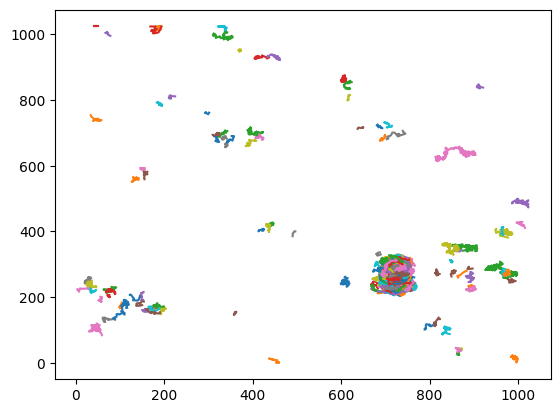

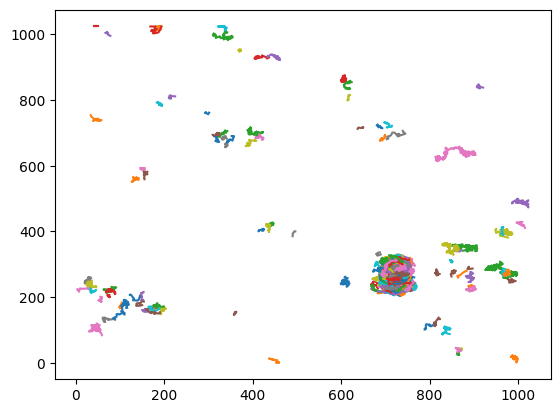

In [74]:
plot_all_particles(output)

In [79]:
def basic_traj_plot(traj):   
    fig = plt.plot(traj['X'], traj['Y'])
    xmin = traj['X'].min()
    xmax = traj['X'].max()
    ymin = traj['Y'].min()
    ymax = traj['Y'].max()

    # xrange = [(xmax+xmin)/2 - 17.5,(xmax+xmin)/2 + 17.5]
    # yrange = [(ymax+ymin)/2 - 17.5,(ymax+ymin)/2 + 17.5]

    xrange = [(xmax+xmin)/2 - 50,(xmax+xmin)/2 + 50]
    yrange = [(ymax+ymin)/2 - 50,(ymax+ymin)/2 + 50]

   
    plt.xlim(xrange)
    plt.ylim(yrange)
    return fig

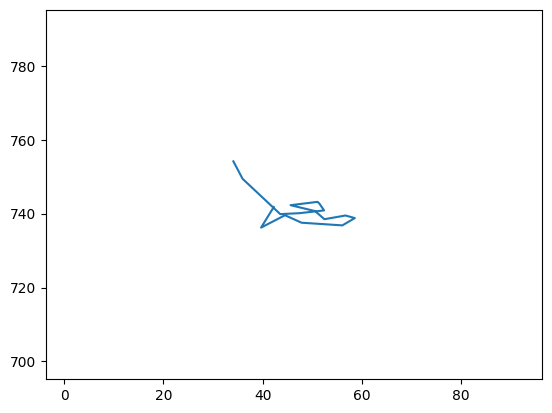

In [81]:
basic_traj_plot(output[output['Track_ID'] == 1])

In [96]:
def basic_traj_plot_altair(traj):
    # Calculate xmin, xmax, ymin, ymax
    xmin = traj['X'].min()
    xmax = traj['X'].max()
    ymin = traj['Y'].min()
    ymax = traj['Y'].max()

    # Define xrange and yrange
    xrange = [(xmax + xmin) / 2 - 50, (xmax + xmin) / 2 + 50]
    yrange = [(ymax + ymin) / 2 - 50, (ymax + ymin) / 2 + 50]

    # Create Altair chart
    chart = alt.Chart(traj).mark_line().encode(
        x=alt.X('X:Q', scale=alt.Scale(domain=xrange)),
        y=alt.Y('Y:Q', scale=alt.Scale(domain=yrange)),
        order='Frame:N'
    ).properties(
        width=600,  # You can adjust the width as needed
        height=400   # You can adjust the height as needed
    )

    return chart


In [97]:
basic_traj_plot_altair(output[output['Track_ID'] == 1])

alt.Chart(...)